In [1]:
from IPython.core.display import HTML
def css():
    style = open("./custom.css", "r").read()
    return HTML(style)
css()

In [2]:
from IPython.display import Image

In [3]:
from IPython.display import HTML
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

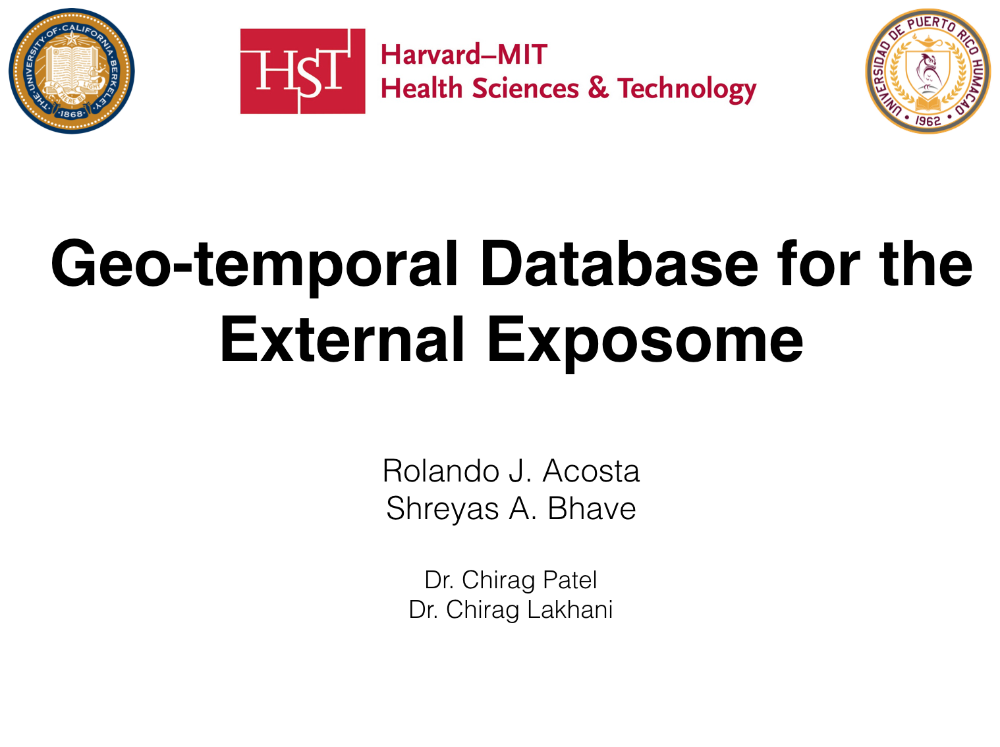

In [8]:
Image(filename='/Users/rolandoacosta/Desktop/introI.png')

Geotemporal Database for Internal and External Exposome
=====
* Rolando J. Acosta & Shreyas A. Bhave
* Dr. Chirag Patel & Dr. Chirag Lakhani


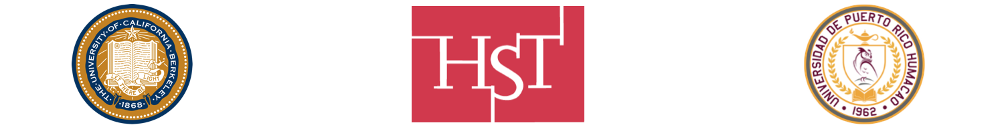

In [3]:
Image(filename='/Users/rolandoacosta/Desktop/intro.png')

What is the external and internal exposome?
====

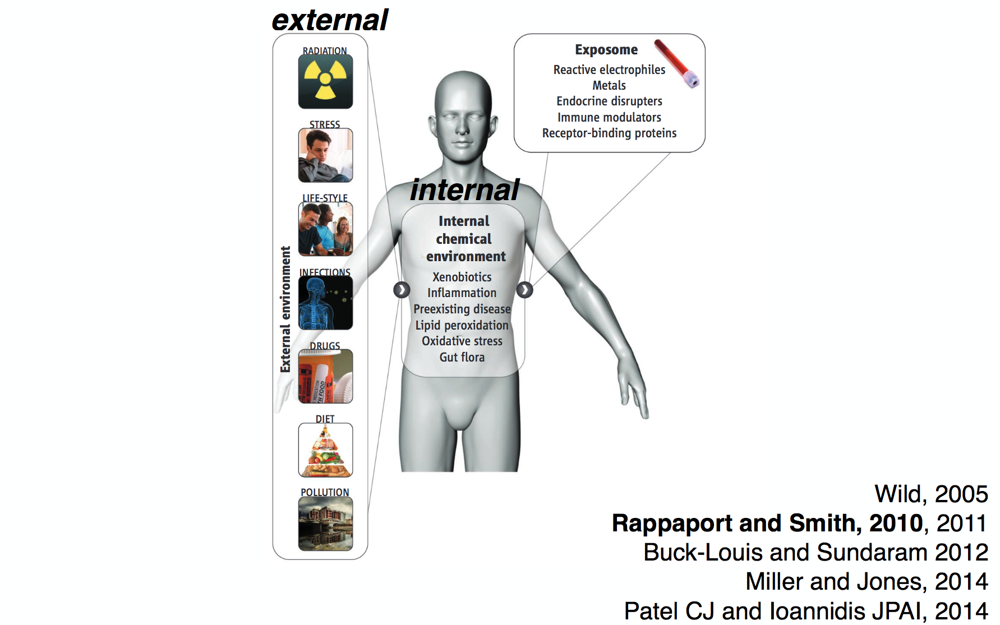

In [5]:
Image(filename='/Users/rolandoacosta/Desktop/exposome.png')

Goals for the summer
====

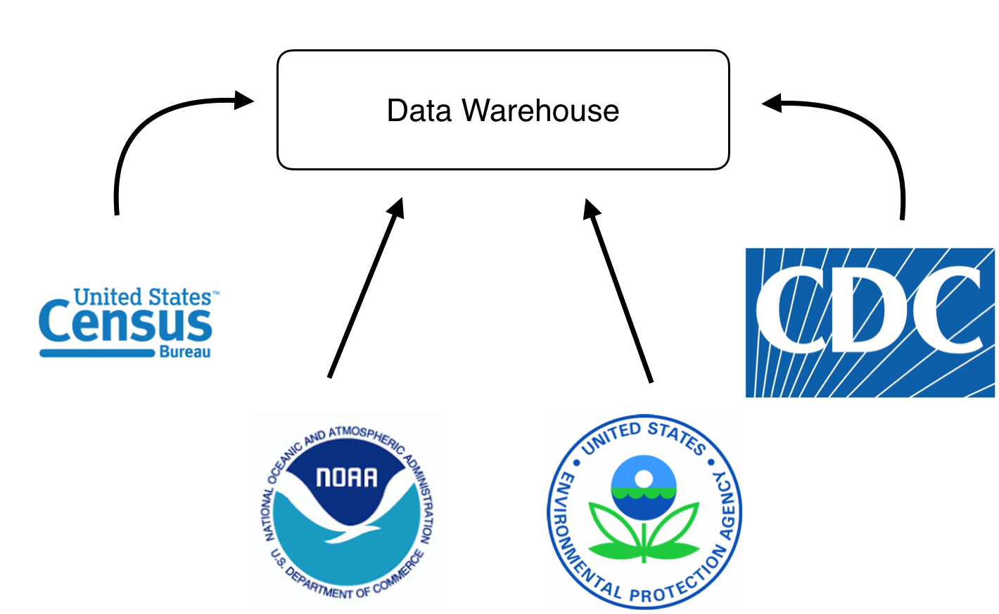

In [6]:
Image(filename='/Users/rolandoacosta/Desktop/sources.png')

Higher level goals of the project
====

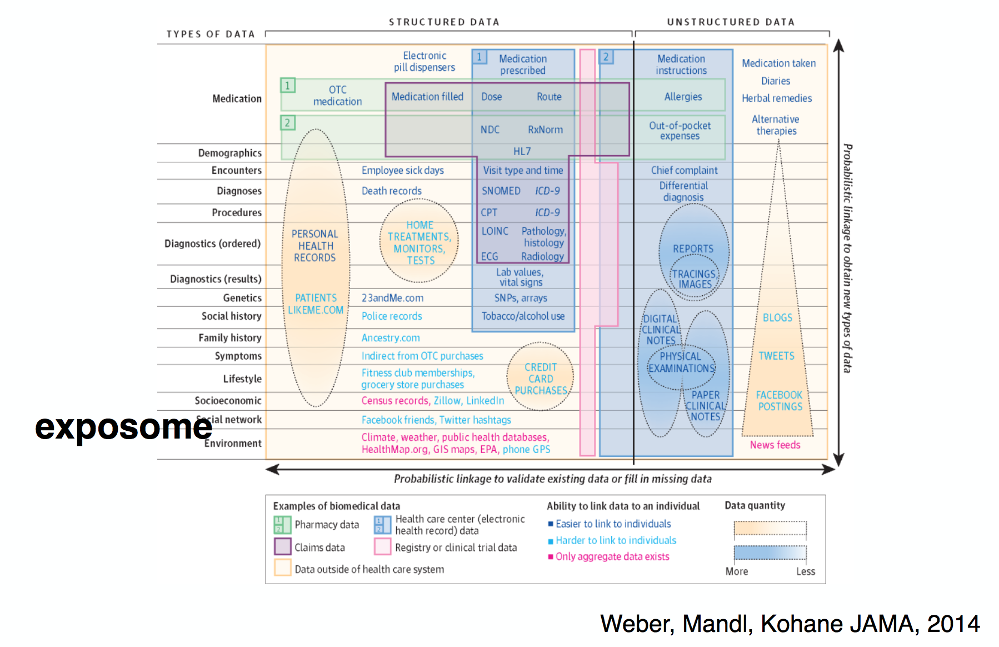

In [2]:
Image(filename='/Users/rolandoacosta/Desktop/goals.png')

Our data
====
* National Oceanographic and Atmospheric Administration (NOAA)
    - Temperature
    - Precipitation
    - Pressure
    - Wind
* Environmental Protection Agency (EPA)
    - Criteria Gases
    - Particulates
    - Meterological
    - Toxics, Precursors, and Lead
* Center for Disease Control (CDC)
    - Mortality
    - Natality
* American Community Survey (ACS)
    - Race
    - Median Income
    - Sex by Age
    - Health Coverage

Raw Data
====
* NOAA (per table)
     - ~8,000 rows for monthly data
     - ~40,000 rows for daily data
     - ~8,000,000 rows for hourly data
* EPA (per table)
     - ~400,000 rows for daily data
     - ~8,000,000 rows for hourly data
* CDC (per table)
     - ~3,000 rows for yearly data
     - ~9,000 rows for monthly data
* Extract - Transform - Load (ETL) Processes 

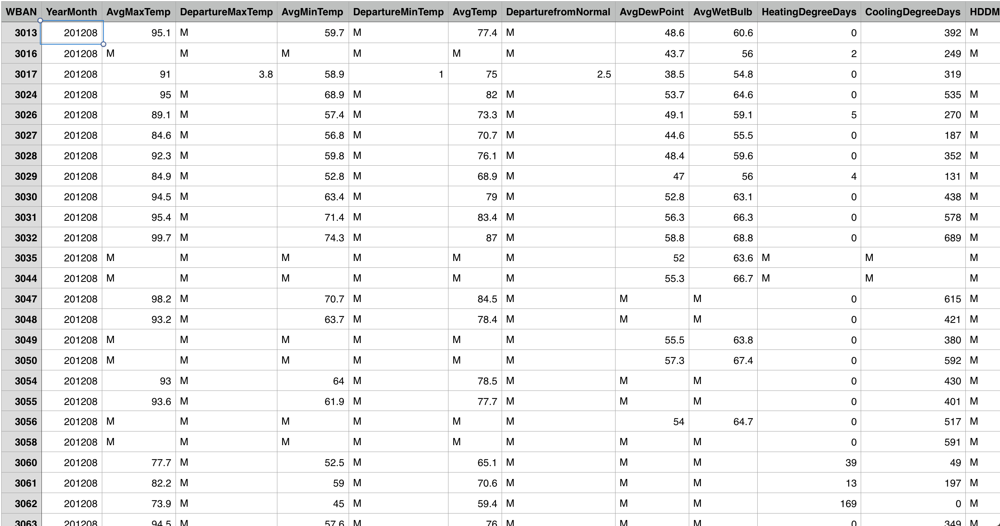

In [5]:
Image(filename='/Users/rolandoacosta/Desktop/noaaexample.png')

* EPA
     - ~400,000 rows for daily data
     - ~8,000,000 rows for hourly data

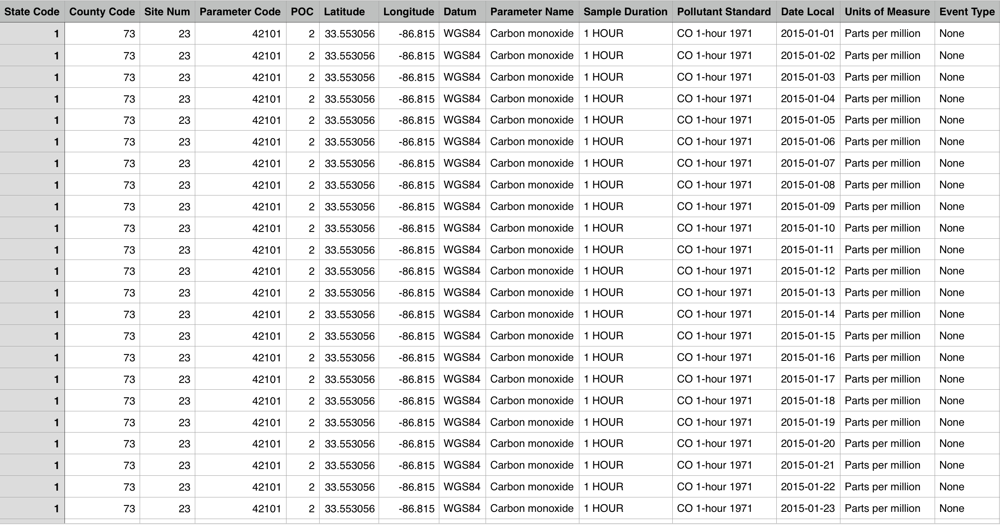

In [6]:
Image(filename='/Users/rolandoacosta/Desktop/epaexample.png')

* CDC Natality
     - ~2,000 rows for yearly data
     - ~8,000 rows for monthly data

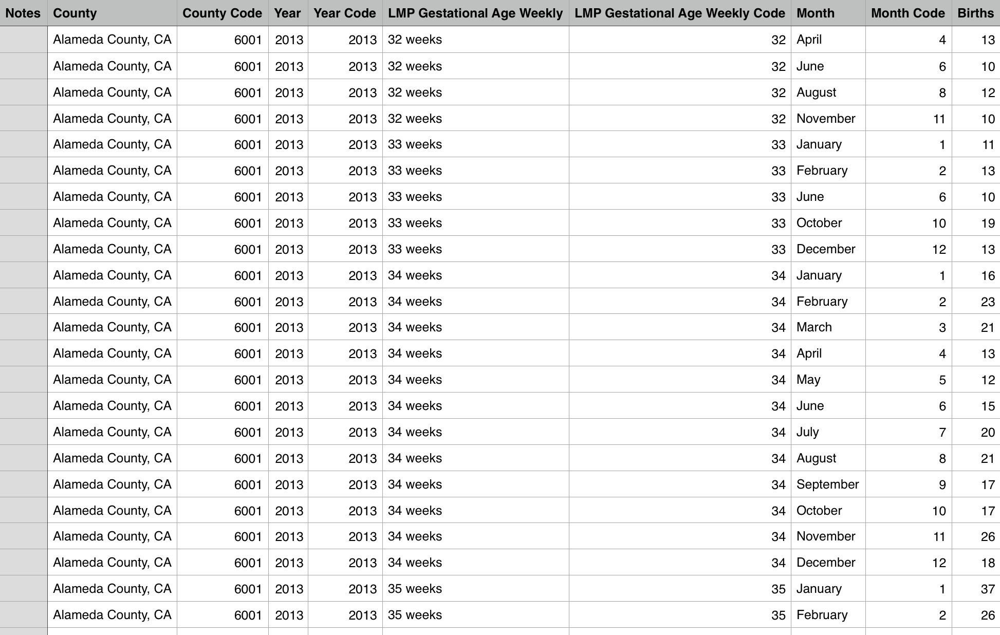

In [3]:
Image(filename='/Users/rolandoacosta/Desktop/cdcnatality.png')

Data model
====

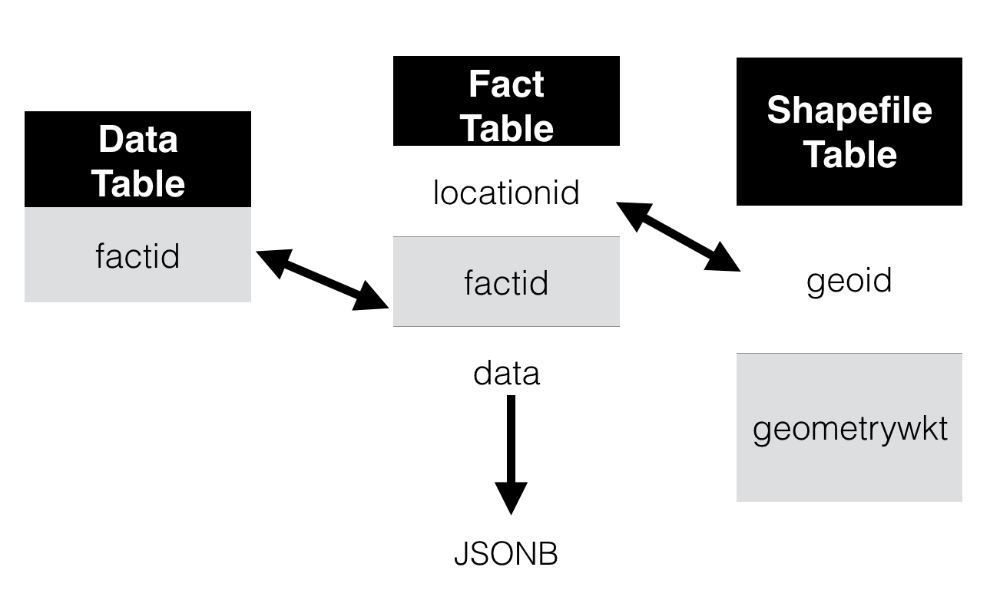

In [23]:
Image(filename='/Users/rolandoacosta/Desktop/datamodel.png')

ETL Process
====
* NOAA
    - DownloadNOAA
        - downloads data
    - read_file(year, month)
        - returns a dataframe of a particular timeframe
    - getTable(year, month, parameter)
        - returns a list of dataframes for a given parameter
    - uploadToDataTable(master_list)
        - populates the data table
    - uploadToShapeFileTable(master_list)
        - populates the shapefile table
    - uploadToFactTable(master_list)
        - populates the fact table

* EPA
    - writeToDataTable()
        - updates data table
    - writeToShapeFileTable()
        - formats each unique sensor lat/lon pair into geometry wkt format
    - writeToFactTable()
        - generates the data json object
        - adds rows for each unique (geoid, startdate, enddate, factid)
    - setupMultiprocessing()
        - multiprocessing library to start several processes in parallel

After ETL
====
* Data table

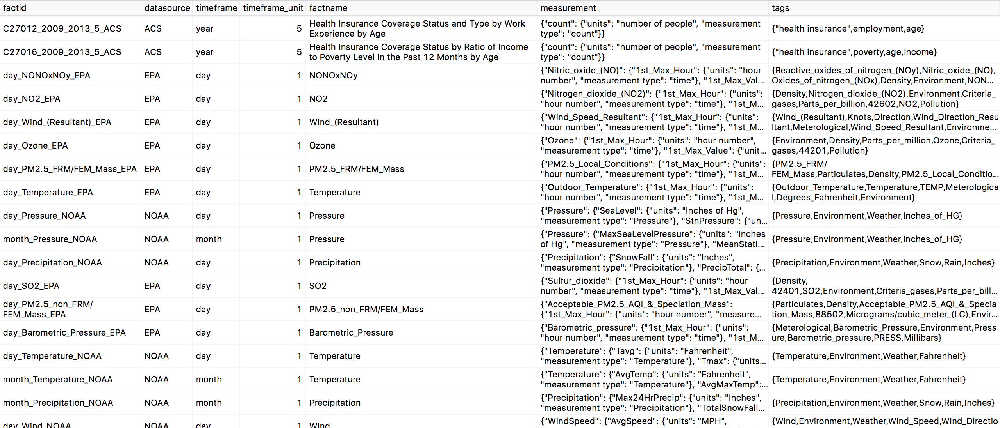

In [13]:
Image(filename='/Users/rolandoacosta/Desktop/dataETL.png')

* Shapefile table

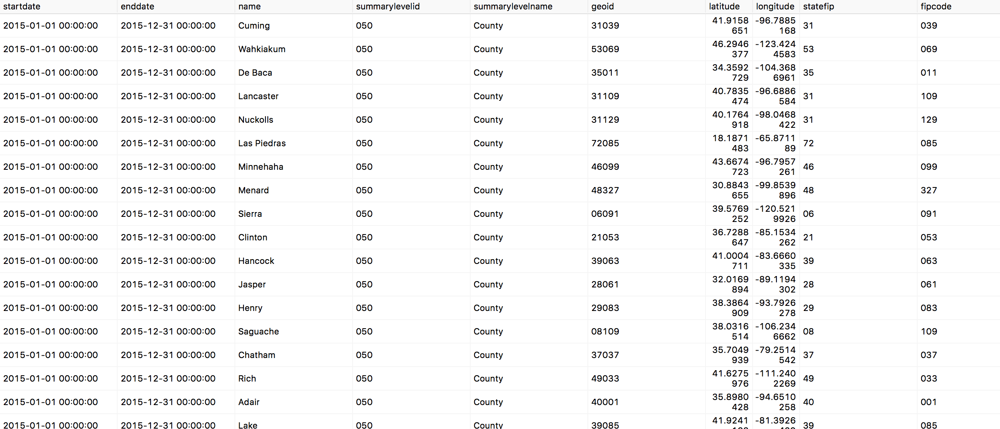

In [14]:
Image(filename='/Users/rolandoacosta/Desktop/shapefileETL.png')

* Fact table

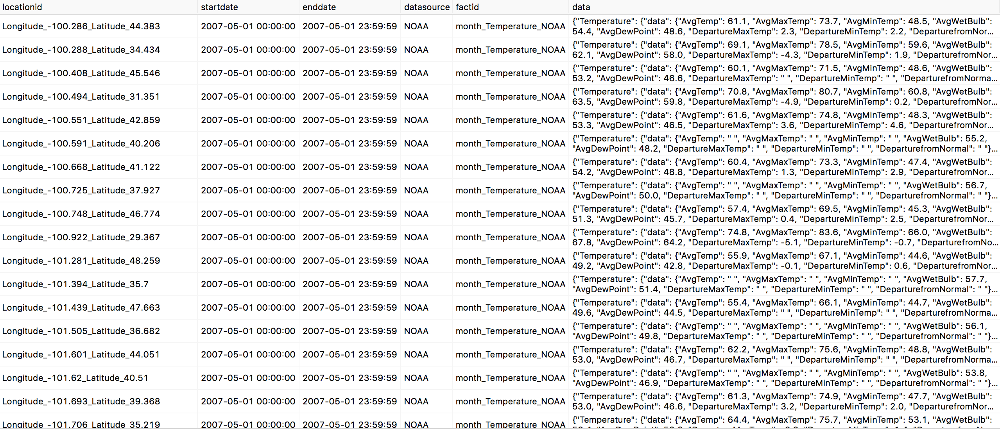

In [15]:
Image(filename='/Users/rolandoacosta/Desktop/factETL.png')

Why jsonb?
====
* Greatly decreases size of the fact table
* Allows data consistency and generalizability
* Good format for the development of an API
* Efficent querying

* Data example

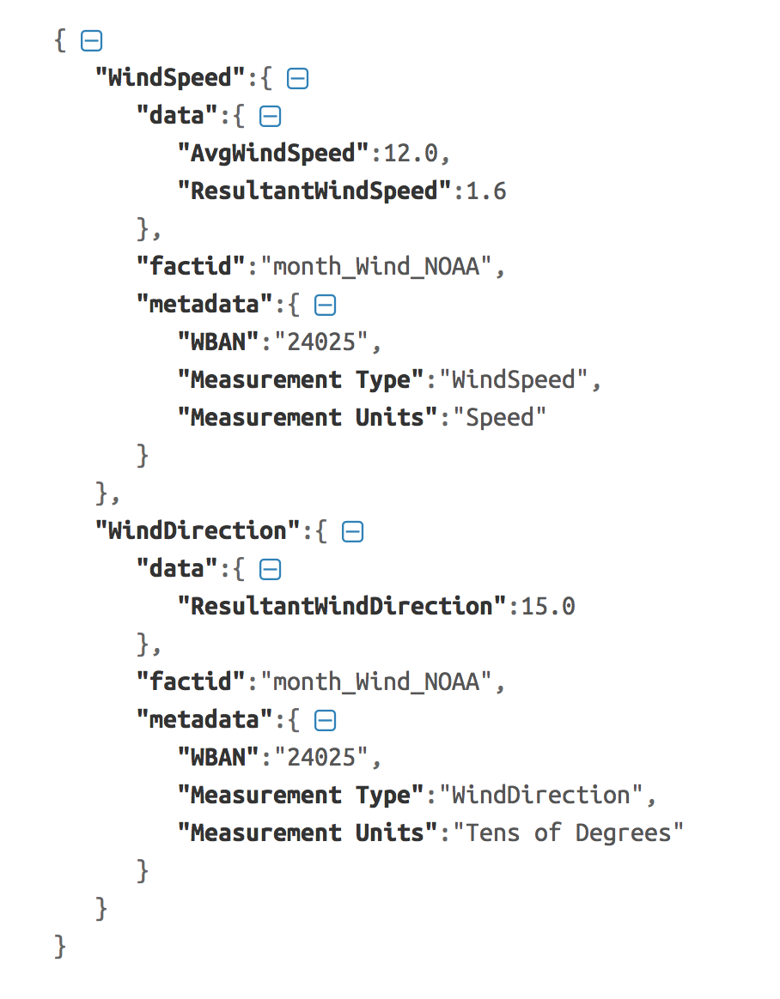

In [11]:
Image(filename='/Users/rolandoacosta/Desktop/JSONBformat.png')

* Example

SELECT locationid, data->’Temperature’->’data’->’AvgTemp’ AS avg_temp FROM facttable WHERE factid = ’month_Temperature_NOAA’ LIMIT 5;

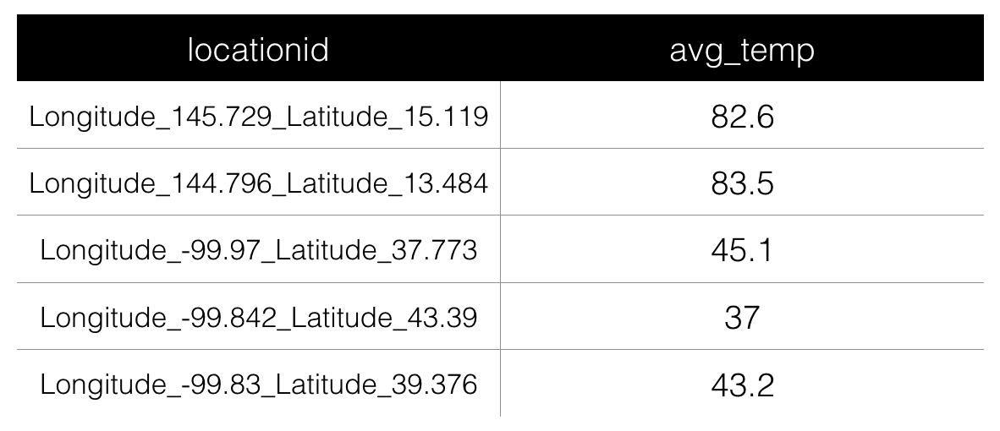

In [9]:
Image(filename='/Users/rolandoacosta/Desktop/quearyexample.png')

Implementation
====
* Implemented in PostgreSQL with the use of PostGIS
* Allows us to do geometrical joins
    - ST_Within(A,B)
    - ST_Intersects(A,B)
    - ST_Distance(A,B) < distance

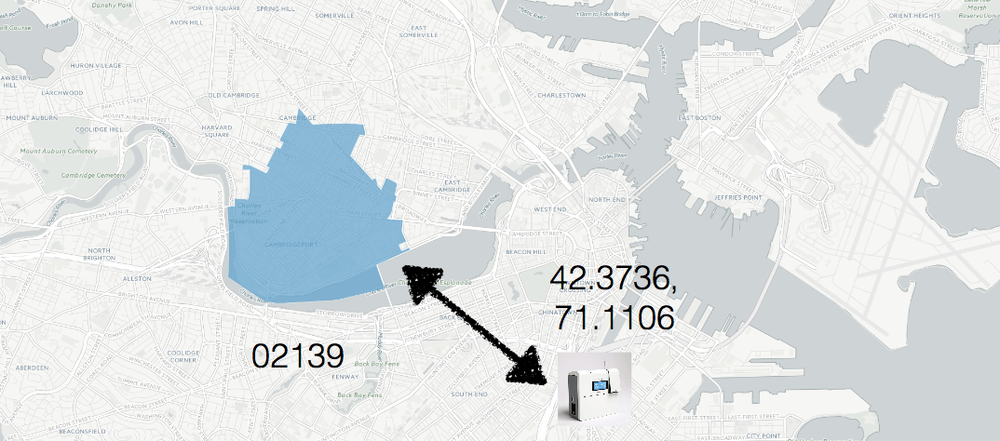

In [21]:
Image(filename='/Users/rolandoacosta/Desktop/geometry.png')

* Example

SELECT sensor.geoid, distance FROM shapefile WHERE county.geoid = '06037' AND ST_Distance(county, sensor) < 15000

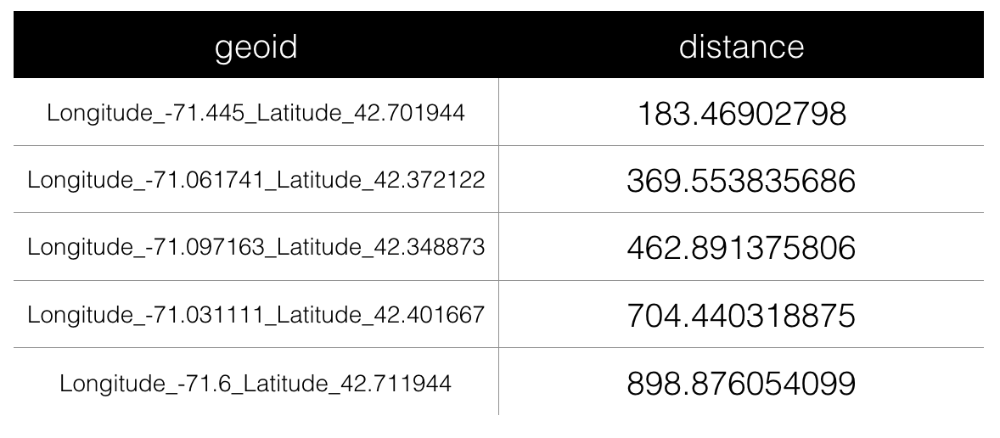

In [8]:
Image(filename='/Users/rolandoacosta/Desktop/geometricjoin.png')

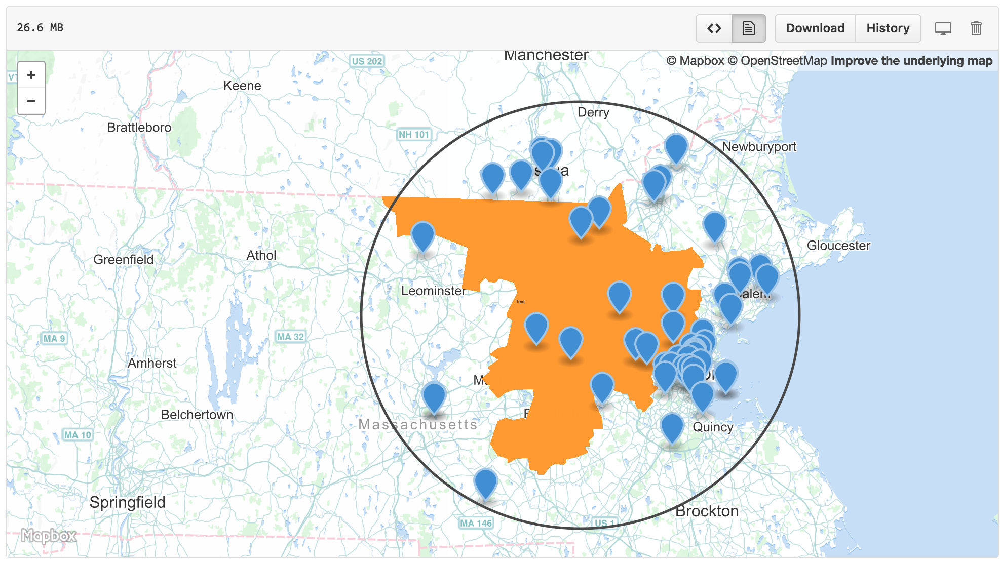

In [12]:
Image(filename='/Users/rolandoacosta/Desktop/geovis.png')

Data Coverage
====
* CDC natality coverage

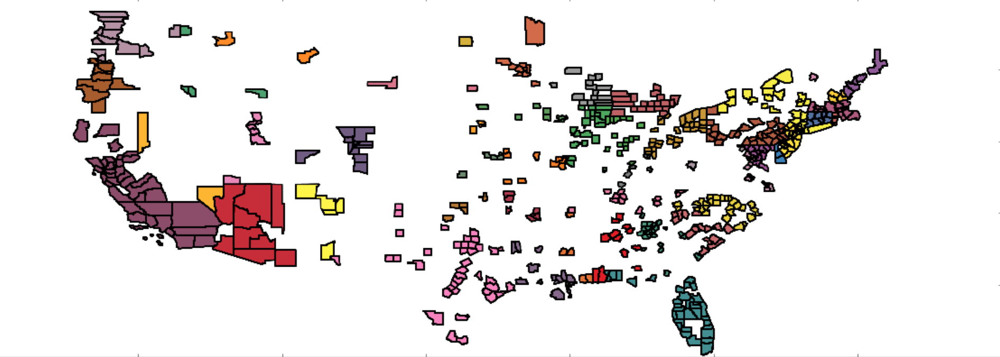

In [7]:
Image(filename='/Users/rolandoacosta/Desktop/natality.png')

* CDC Mortality coverage

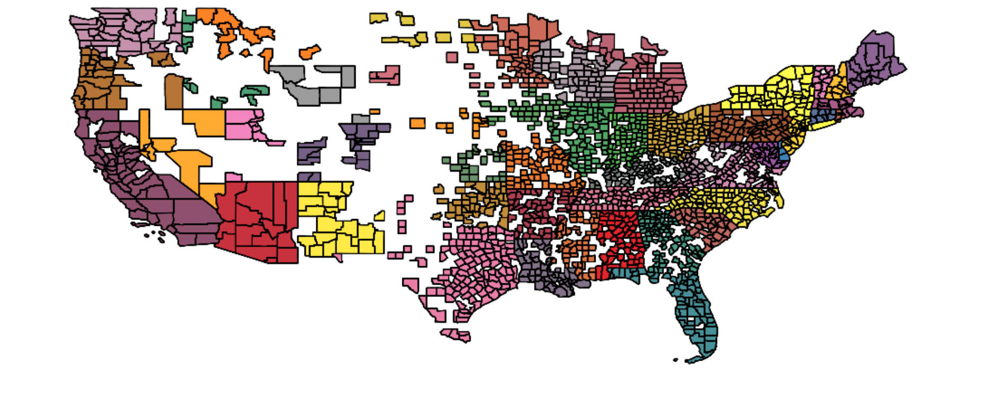

In [6]:
Image(filename='/Users/rolandoacosta/Desktop/mortality.png')

* EPA coverage

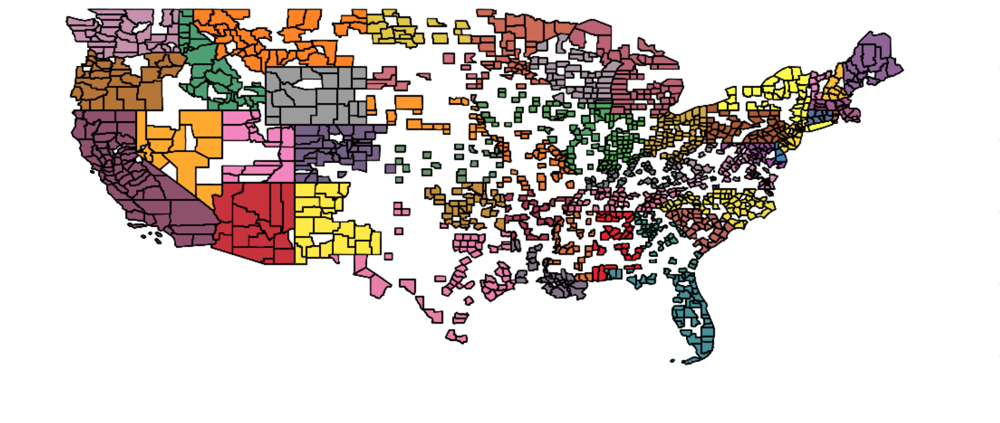

In [4]:
Image(filename='/Users/rolandoacosta/Desktop/epa.png')

* NOAA coverage

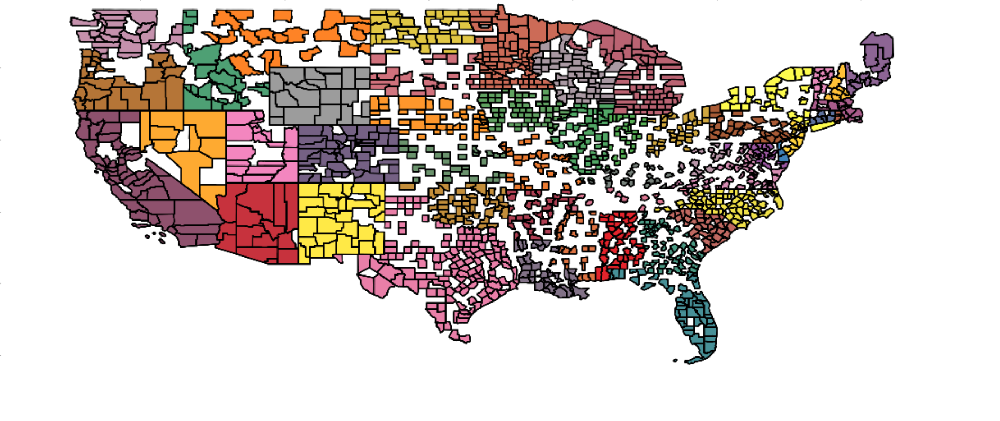

In [3]:
Image(filename='/Users/rolandoacosta/Desktop/noaa.png')

To summarize
====

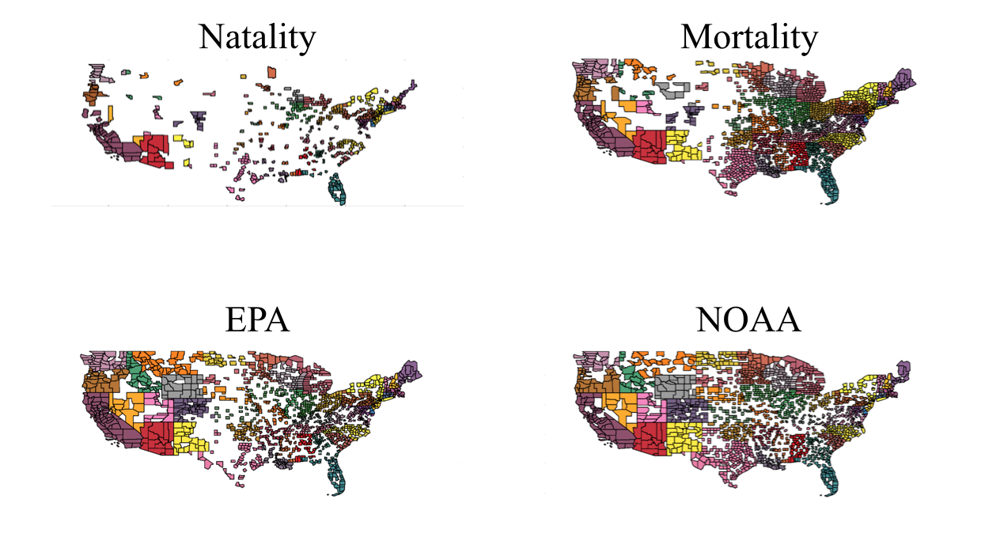

In [3]:
Image(filename='/Users/rolandoacosta/Desktop/allmaps.png')

* ACS coverage

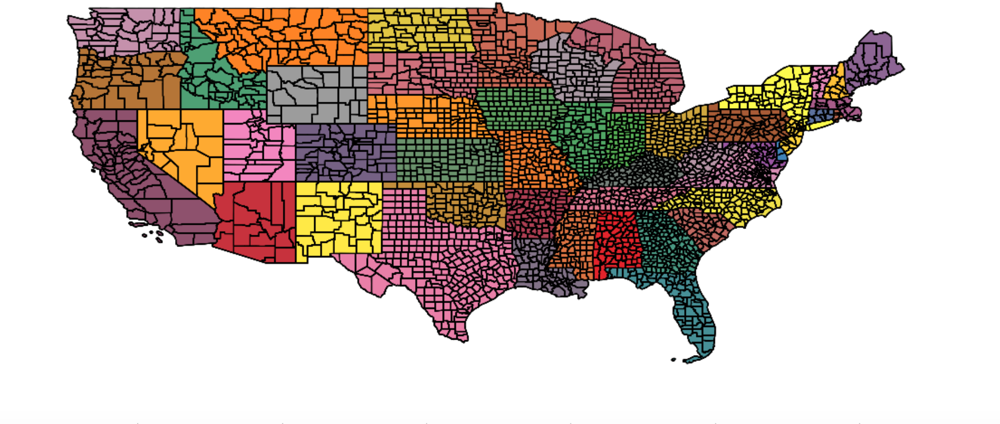

In [8]:
Image(filename='/Users/rolandoacosta/Desktop/acs.png')

Advantages
====
* Simultaneous analysis of data from different sources
* Flexibility and spatial granularity of analysis

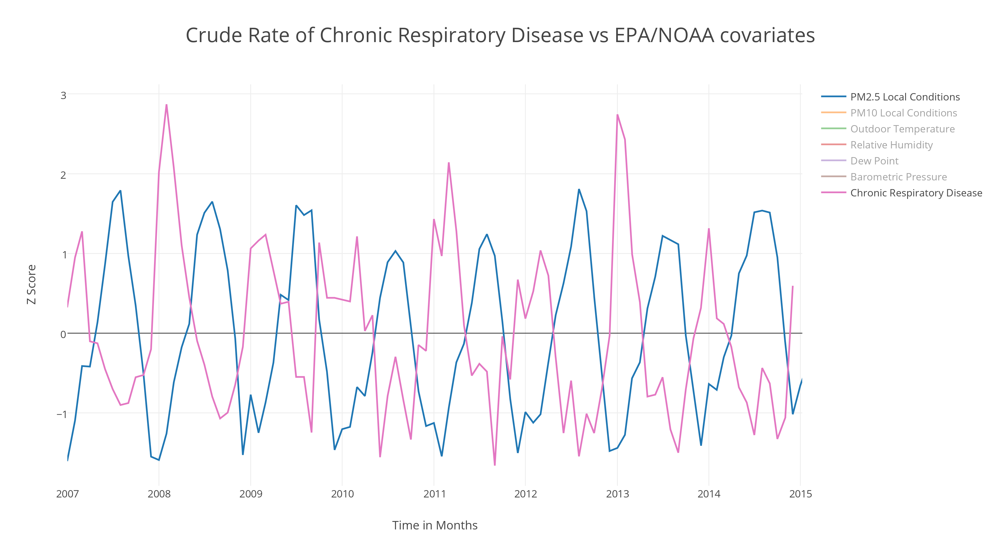

In [4]:
Image(filename='/Users/rolandoacosta/Desktop/Respiratory_vs_PM2.5.png')

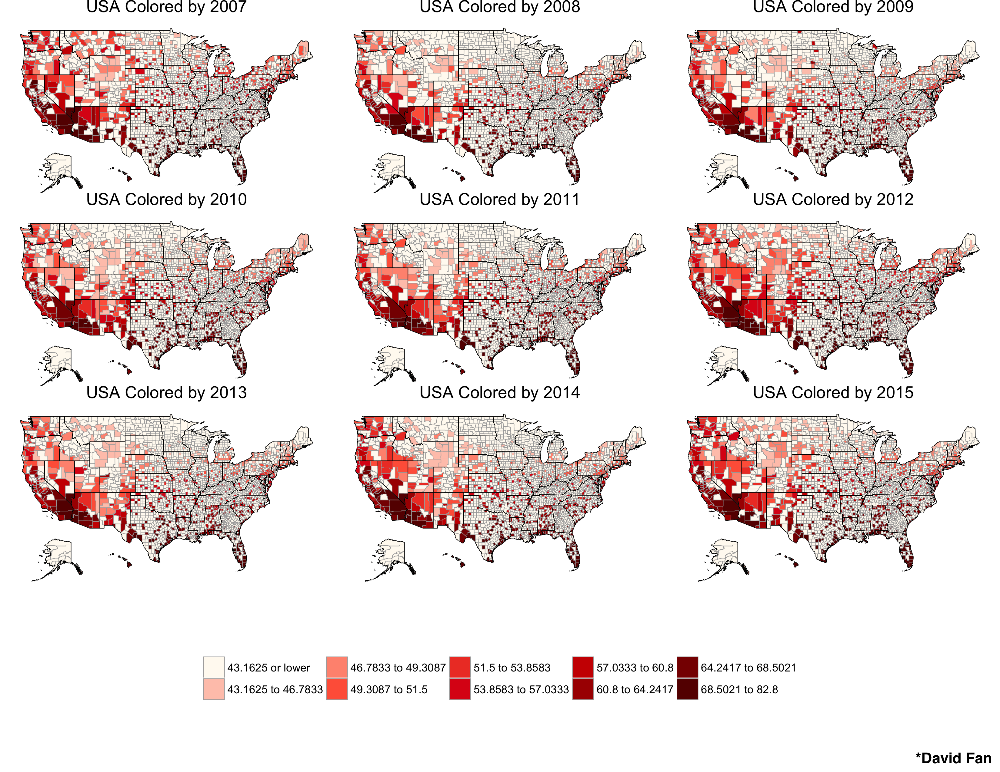

In [19]:
Image(filename='/Users/rolandoacosta/Desktop/noaa_3x3_county.png')

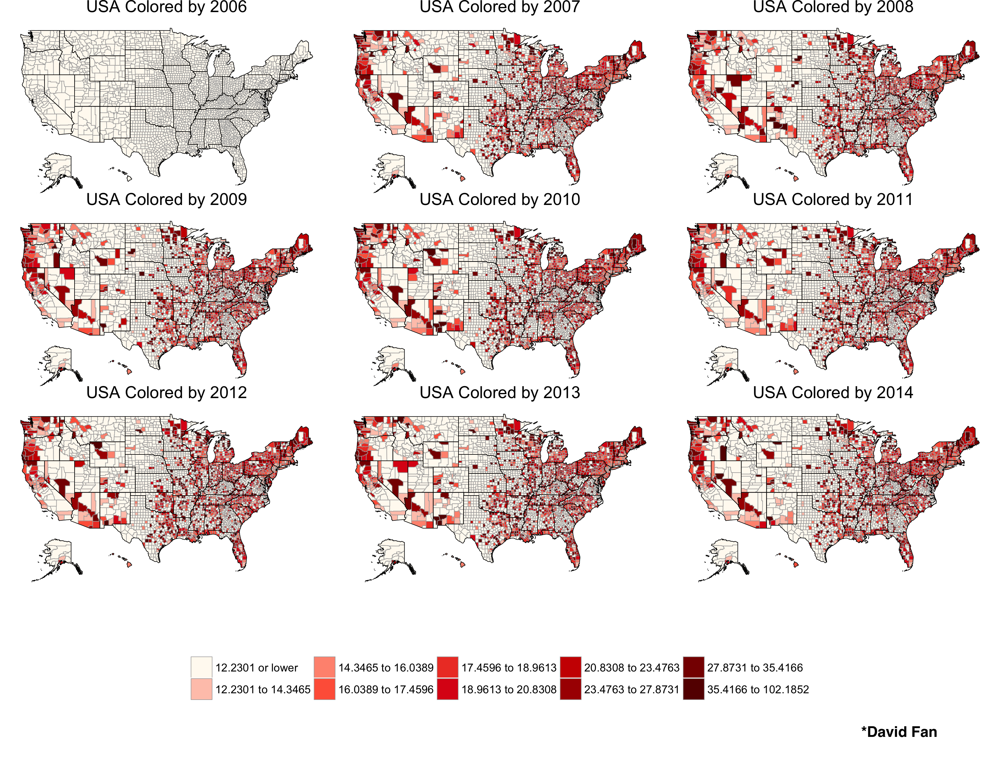

In [20]:
Image(filename='/Users/rolandoacosta/Desktop/cdc_3x3_county.png')

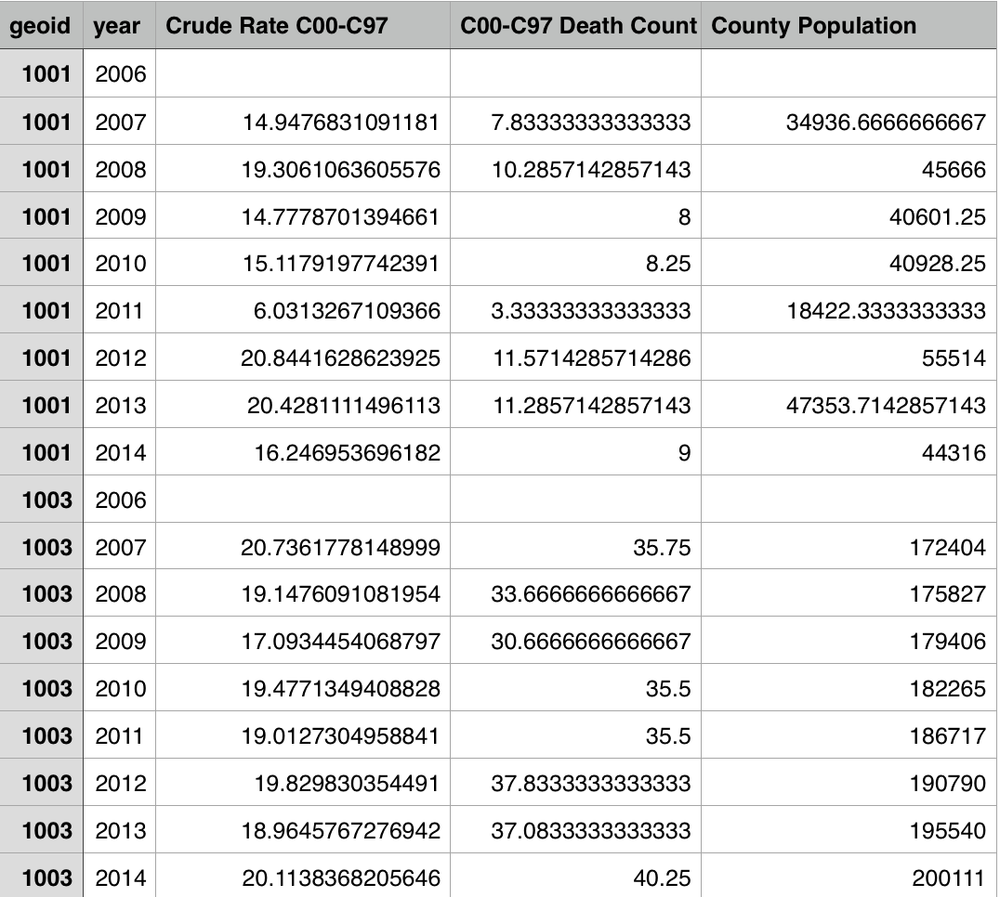

In [4]:
Image(filename='/Users/rolandoacosta/Desktop/Data_Table_Malignant_Neoplasms.png')

Importance of our work
====
* Environmental and health data from different sources are stored in one centralized data warehouse.
* Information can be distributed as a function of time and space. 
* Opens the door for analyzing disease outcomes as a function of environmental factors on a greater scale

Database Middleware - The Beginnings of an API
====
* Constructing these datatables is not intuitive at first for users
* Building a backend to easily construct queries for these kind of tables with user input
* Shiny app was built as a proof of concept of this backend framework
* Backend was done in python

How it Works - The Shiny App
====
* Users:
    * Provide tags (based on broad categories and specific parameters) for the data
    * Specify time frame
    * Specify date range
    * Specify response variables (ICD-10 codes)
    * Specify particular counties (in this case)
* Backend:
    * Extracts relevant factids
    * Finds all sensors in the given counties with geometric joins
    * Averages data across sensors 
    * Identifies data that needs to be rolled up (e.g. requests month but have day)
    * Limits time frame of facts given

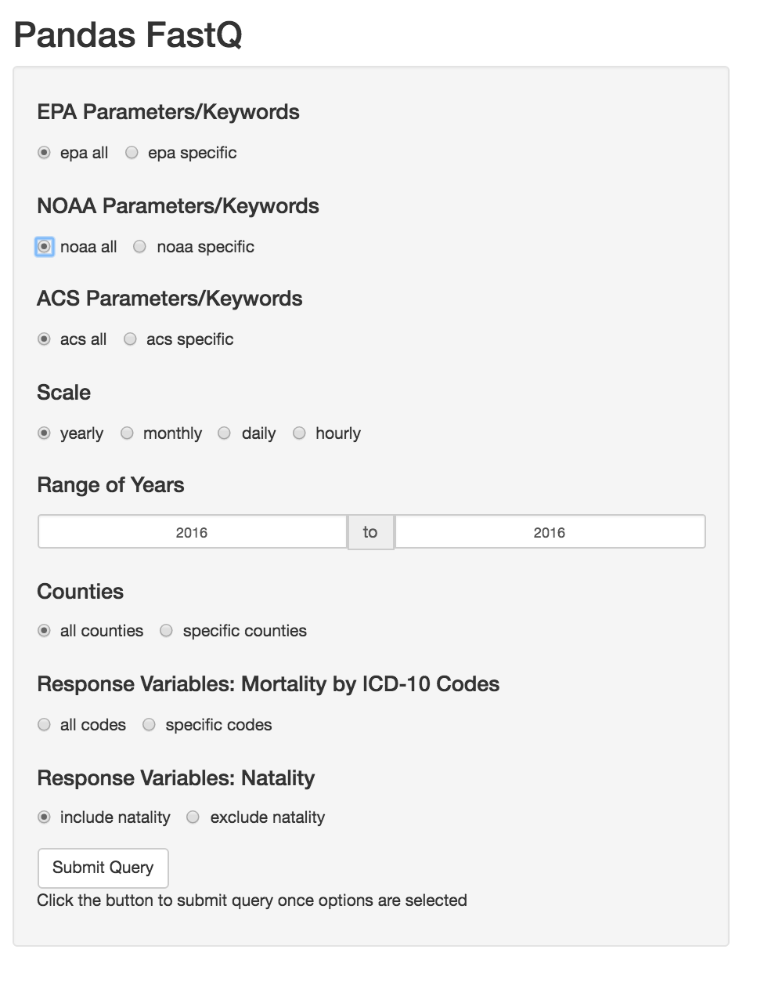

In [4]:
Image(filename='/Users/rolandoacosta/Desktop/shinyUI1.png')

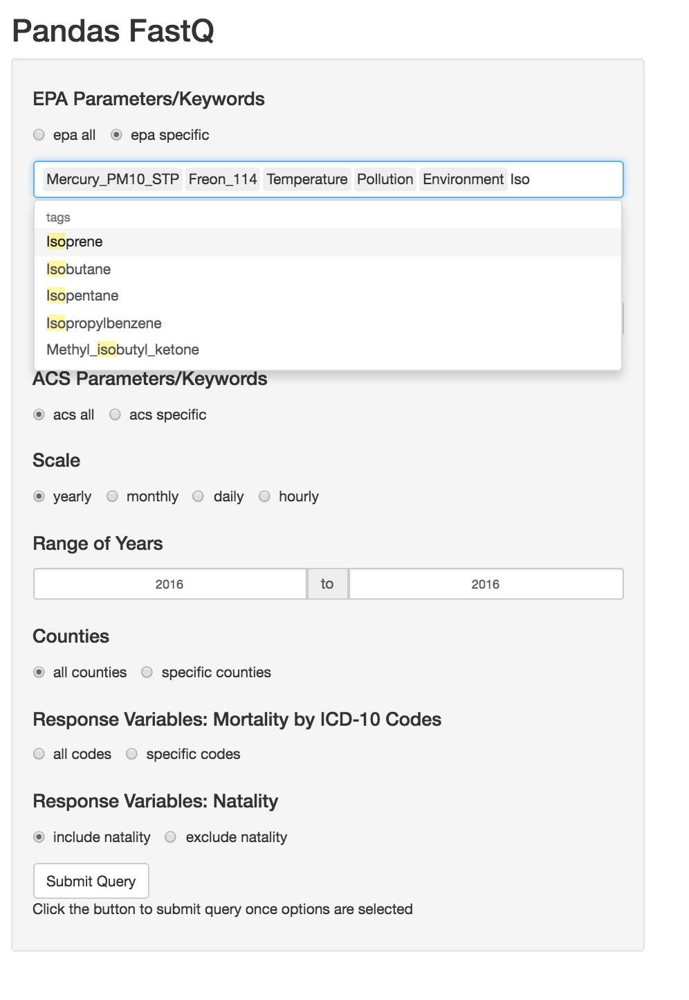

In [7]:
Image(filename='/Users/rolandoacosta/Desktop/shinyUI2.png')

Analysis of Prevalance Due to Environmental Factors
====
* Prevalence as a function of time delay covariates 
    - Linear Mixed Effect Models to account for random effect across counties, months, and years
    - We have scripts to run analysis on a large scale using a Linear Mixed Effect Model

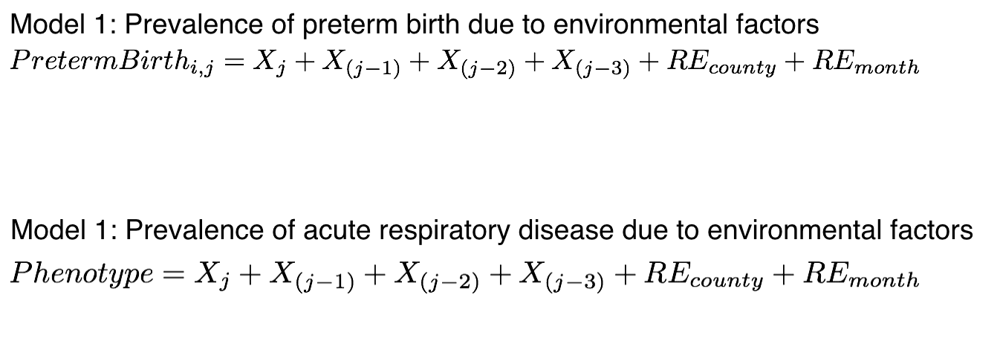

In [3]:
Image(filename='/Users/rolandoacosta/Desktop/model.png')

Future Work
====
* Ingestion of other public sources (e.g., USDA, NASA, Facebook, and Twitter)
* Developing a Visualization Platform and larger scale API
* Regional cluster of phenotype and environmental factors
* Use of Proportional Hazards Model (Cox Models) for analysis of preterm birth

Conclusion
=====
* Combine with EMR and other levels in the PIC-SURE initiative

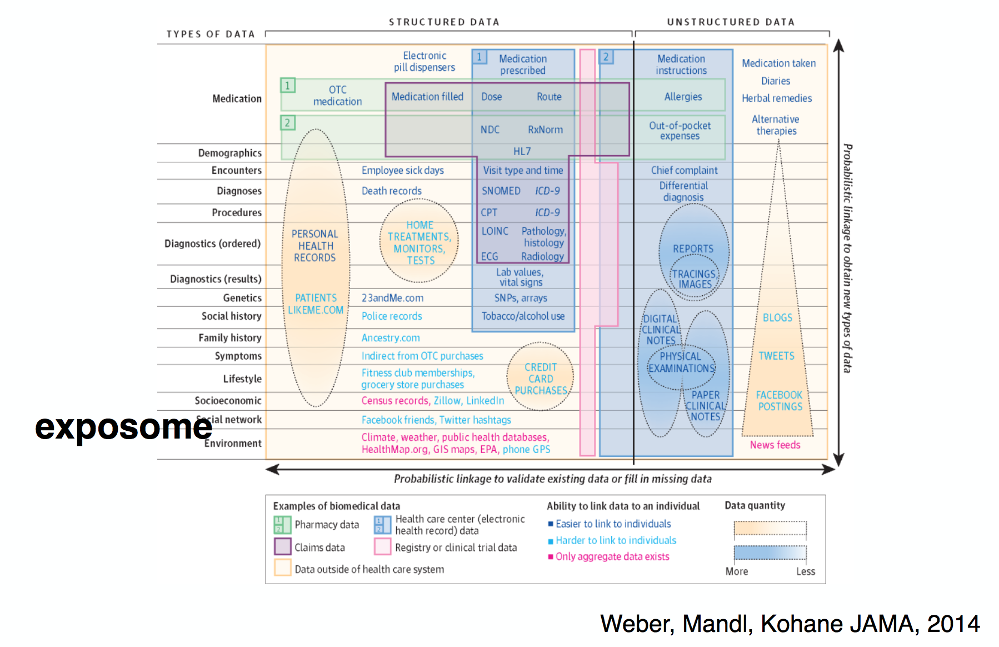

In [4]:
Image(filename='/Users/rolandoacosta/Desktop/goals.png')

Acknowledgement
====
* Dr. Chirag Patel
* Dr. Chirag Lakhani
* Department of Biomedical Informatics in Harvard
* Staff of the HMS-DBMI/HST Summer Institute in Biomedical Informatics
